# Vanilla differential expression on Packer C. elegdans data using single-cell Variational Inference (scVI)

Processing and visualizing 89k cells from Packer et al. 2019 C. elegans 10xv2 single cell data

Original article:
`A lineage-resolved molecular atlas of C. elegans embryogenesis at single-cell resolution`

https://science.sciencemag.org/content/365/6459/eaax1971.long

### Steps performed:

1. Loading the data from anndata containing cell labels and gene descriptions from WormBase
2. Training the model with batch labels for integration with scVI
3. Retrieving the scVI latent space and imputed values
4. Visualize the latent space with t-SNE, UMAP and PCA using Plotly
5. Perform differential expression and visualize with interactive volcano plot and heatmap using Plotly


In [1]:
# Uncomment to install packages if running on colab
# !pip install scvi
# !pip install anndata
# !pip install umap-learn
# !pip install 'openTSNE==0.3.9'


In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import os
import numpy as np
import pandas as pd



import matplotlib.pyplot as plt
from scvi.dataset import GeneExpressionDataset
from scvi.models import VAE
from scvi.inference import UnsupervisedTrainer
import torch
import anndata

import plotly.express as px
import plotly.graph_objects as go

from openTSNE import TSNE
from openTSNE.callbacks import ErrorLogger
from sklearn.decomposition import TruncatedSVD
import umap

#openTSNE and UMAP are giving a bunch of annoying warning because of numba
import warnings; warnings.simplefilter('ignore')



[2019-11-29 22:45:21,423] INFO - scvi._settings | Added StreamHandler with custom formatter to 'scvi' logger.
/Users/munfred/anaconda3/lib/python3.7/site-packages/sklearn/utils/linear_assignment_.py:21: DeprecationWarning: The linear_assignment_ module is deprecated in 0.21 and will be removed from 0.23. Use scipy.optimize.linear_sum_assignment instead.
  DeprecationWarning)


In [4]:
# Change the path where the models will be saved 
save_path = "./"

if os.path.isfile('packer.h5ad'):
    print ("Found the data file! No need to download.")
else:
    print ("Downloading data...")
    ! wget https://github.com/Munfred/worm-notebooks/releases/download/Packer/packer.h5ad


Found the data file! No need to download.


In [5]:
adata = anndata.read('packer.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 89701 × 20222 
    obs: 'cell', 'numi', 'time_point', 'batch', 'size_factor', 'cell_type', 'cell_subtype', 'plot_cell_type', 'raw_embryo_time', 'embryo_time', 'embryo_time_bin', 'raw_embryo_time_bin', 'lineage', 'passed_qc'
    var: 'gene_id', 'gene_name', 'gene_description'

In [7]:
adata.X

<89701x20222 sparse matrix of type '<class 'numpy.float32'>'
	with 82802059 stored elements in Compressed Sparse Column format>

### Take a look at the gene descriptions
The gene descriptions were taken using the WormBase API, see the documenation at

https://wormbase.org/about/userguide/for_developers#3--10


In [8]:
display(adata.var.head().style.set_properties(subset=['gene_description'], **{'width': '600px'}))

,gene_id,gene_name,gene_description
index,,,
WBGene00010957,WBGene00010957,nduo-6,Is affected by several genes including daf-16; daf-12; and hsf-1 based on RNA-seq and tiling array studies. Is affected by six chemicals including Rotenone; Psoralens; and metformin based on RNA-seq and microarray studies.
WBGene00010958,WBGene00010958,ndfl-4,Is enriched in Psub2 based on RNA-seq studies. Is affected by several genes including daf-16; daf-12; and clk-1 based on RNA-seq and microarray studies. Is affected by six chemicals including Alovudine; Psoralens; and metformin based on RNA-seq studies.
WBGene00010959,WBGene00010959,nduo-1,Is an ortholog of human MT-ND1 (mitochondrially encoded NADH:ubiquinone oxidoreductase core subunit 1). Is predicted to contribute to NADH dehydrogenase activity. Human ortholog(s) of this gene are implicated in Leber hereditary optic neuropathy and MELAS syndrome.
WBGene00010960,WBGene00010960,atp-6,"Is predicted to contribute to proton-transporting ATP synthase activity, rotational mechanism."
WBGene00010961,WBGene00010961,nduo-2,Is affected by several genes including hsf-1; clk-1; and elt-2 based on RNA-seq and microarray studies. Is affected by eight chemicals including stavudine; Zidovudine; and Psoralens based on RNA-seq and microarray studies.


In [9]:
# take a look at the cell annotation
adata.obs.head().T

index,AAACCTGAGACAATAC-300.1.1,AAACCTGAGGGCTCTC-300.1.1,AAACCTGAGTGCGTGA-300.1.1,AAACCTGAGTTGAGTA-300.1.1,AAACCTGCAAGACGTG-300.1.1
cell,AAACCTGAGACAATAC-300.1.1,AAACCTGAGGGCTCTC-300.1.1,AAACCTGAGTGCGTGA-300.1.1,AAACCTGAGTTGAGTA-300.1.1,AAACCTGCAAGACGTG-300.1.1
numi,1630,2319,3719,4251,1003
time_point,300_minutes,300_minutes,300_minutes,300_minutes,300_minutes
batch,Waterston_300_minutes,Waterston_300_minutes,Waterston_300_minutes,Waterston_300_minutes,Waterston_300_minutes
size_factor,1.02319,1.45821,2.33828,2.65905,0.62961
cell_type,Body_wall_muscle,nan,nan,Body_wall_muscle,Ciliated_amphid_neuron
cell_subtype,BWM_head_row_1,nan,nan,BWM_anterior,AFD
plot_cell_type,BWM_head_row_1,nan,nan,BWM_anterior,AFD
raw_embryo_time,360,260,270,260,350
embryo_time,380,220,230,280,350


## Loading data

We load the Packer data and use the batch annotations for scVI

In [10]:
gene_dataset = GeneExpressionDataset()

# we provide the `batch_indices` so that scvi can perform batch correction
gene_dataset.populate_from_data(
            adata.X,
            gene_names=adata.var.index.values,
            cell_types=adata.obs['cell_type'].values,
            batch_indices=adata.obs['batch'].cat.codes.values,
            )

# We select the 1000 most variable genes, which is the default selection criteria of scvi
gene_dataset.subsample_genes(1000)
sel_genes = gene_dataset.gene_names


[2019-11-29 22:45:27,358] INFO - scvi.dataset.dataset | Remapping batch_indices to [0,N]
[2019-11-29 22:45:27,361] INFO - scvi.dataset.dataset | Remapping labels to [0,N]
[2019-11-29 22:45:29,074] INFO - scvi.dataset.dataset | Downsampling from 20222 to 1000 genes
[2019-11-29 22:45:29,199] INFO - scvi.dataset.dataset | Computing the library size for the new data
[2019-11-29 22:45:29,705] INFO - scvi.dataset.dataset | Filtering non-expressing cells.
[2019-11-29 22:45:29,916] INFO - scvi.dataset.dataset | Computing the library size for the new data
[2019-11-29 22:45:30,303] INFO - scvi.dataset.dataset | Downsampled from 89701 to 89701 cells


In [11]:
adata.obs['cell_type'].values

[Body_wall_muscle, nan, nan, Body_wall_muscle, Ciliated_amphid_neuron, ..., Rectal_gland, nan, nan, nan, nan]
Length: 89701
Categories (37, object): [ABarpaaa_lineage, Arcade_cell, Body_wall_muscle, Ciliated_amphid_neuron, ..., hmc_and_homolog, hmc_homolog, hyp1V_and_ant_arc_V, nan]

## Training

<div style="max-width: 60em;">

* __n_epochs__: Maximum number of epochs to train the model. If the likelihood change is small than a set threshold training will stop automatically. 
* __lr__: learning rate. Set to 0.001 here. 
* __use_batches__: If the value of true than batch information is used in the training. Here it is set to false because the cortex data only contains one batch. 
* __use_cuda__: Set to true to use CUDA (GPU required) 


In [12]:
# for this dataset 5 epochs is sufficient 
n_epochs = 5
lr = 1e-3
use_batches = True
use_cuda = True

We now create the model and the trainer object. We train the model and output model likelihood every epoch. In order to evaluate the likelihood on a test set, we split the datasets (the current code can also so train/validation/test).

If a pre-trained model already exist in the save_path then load the same model rather than re-training it. This is particularly useful for large datasets.

In [13]:
vae = VAE(gene_dataset.nb_genes, n_batch=gene_dataset.n_batches * use_batches)

trainer = UnsupervisedTrainer(
    vae,
    gene_dataset,
    train_size=0.75,
    use_cuda=use_cuda,
    frequency=1,
)

# Uncomment to save model
if os.path.isfile('%s/vae.pkl' % save_path):
    trainer.model.load_state_dict(torch.load('%s/vae.pkl' % save_path))
    trainer.model.eval()
else:
    trainer.train(n_epochs=n_epochs, lr=lr)
    torch.save(trainer.model.state_dict(), '%s/vae.pkl' % save_path)

training: 100%|██████████| 5/5 [06:42<00:00, 80.53s/it]


### Plotting the likelihood change across training


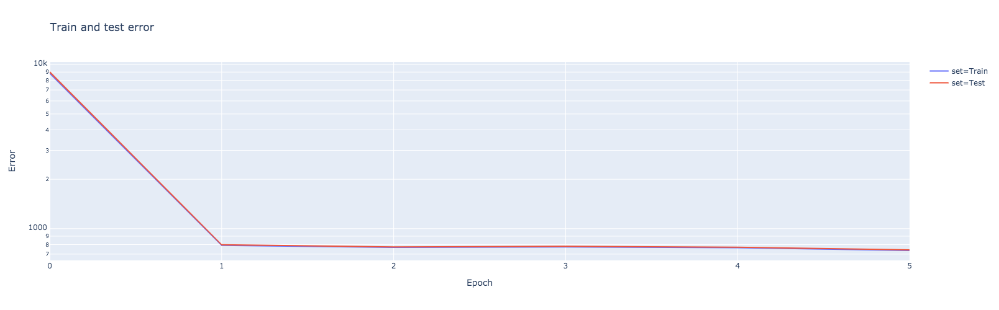

In [14]:
# I decided to see if I could do it in "one line" with plotly express (which is cool but still missing customization options)
fig = px.line(pd.DataFrame(trainer.history).rename(columns={'elbo_train_set':'Train', 'elbo_test_set':'Test'}).reset_index().melt(id_vars='index').rename(columns={'index':'Epoch', 'value':'Error', 'variable':'set'}) 
              , x ='Epoch'
              , y= 'Error'
              , color='set'
              , log_y = True
              , title= 'Train and test error'
             )
fig.update_layout(legend_orientation="v", height=500, width=800)

fig.show()


## Obtaining the posterior object and sample latent space as well as imputation from it
<div style="max-width: 60em;">

The posterior object contains a model and a gene_dataset, as well as additional arguments that for Pytorch's `DataLoader`. It also comes with many methods or utilities querying the model, such as differential expression, imputation and differential analyisis.


To get an ordered output result, we might use `.sequential` posterior's method which return another instance of posterior (with shallow copy of all its object references), but where the iteration is in the same ordered as its  indices attribute.

In [15]:
full = trainer.create_posterior(trainer.model, gene_dataset, indices=np.arange(len(gene_dataset)))
latent, batch_indices, labels = full.sequential().get_latent()
batch_indices = batch_indices.ravel()

<div style="max-width: 60em;">

Similarly, it is possible to query the imputed values via the `imputation` method of the posterior object. 
    
**Note for advanced users:** imputation is an ambiguous term and there are two ways to perform imputation in scVI.  
The first way is to query the **mean of the negative binomial** distribution modeling the counts.  
This is referred to as `sample_rate` in the codebase and can be reached via the `imputation` method.   
The second is to query the **normalized mean of the same negative binomial** (please refer to the scVI manuscript).   
This is referred to as `sample_scale` in the codebase and can be reached via the `get_sample_scale` method.   
In differential expression for example, we of course rely on the normalized latent variable which is corrected for variations in sequencing depth.  

In [16]:
imputed_values = full.sequential().imputation()
normalized_values = full.sequential().get_sample_scale()

In [17]:
# scvi tutorial latent space code
full = trainer.create_posterior(trainer.model, gene_dataset, indices=np.arange(len(gene_dataset)))
latent, batch_indices, labels = full.sequential().get_latent()
batch_indices = batch_indices.ravel()
latent.shape

(89701, 10)

In [18]:
post_adata = anndata.AnnData(X=gene_dataset.X)
post_adata.obs=adata.obs
post_adata.obsm["latent"] = latent
post_adata

AnnData object with n_obs × n_vars = 89701 × 1000 
    obs: 'cell', 'numi', 'time_point', 'batch', 'size_factor', 'cell_type', 'cell_subtype', 'plot_cell_type', 'raw_embryo_time', 'embryo_time', 'embryo_time_bin', 'raw_embryo_time_bin', 'lineage', 'passed_qc'
    obsm: 'latent'

# Plotting Embeddings
### Using Plotly's `Scattergl` we can easily and _speedily_ make interactive plots with 89k cells!

In [19]:
# here's a hack to randomize categorical colors, since plotly can't do that in a straightforward manner
# we take the list of named css colors that it recognizes, and we picked a color based on the code of
# the cluster we are coloring
css_colors=[
'aliceblue','antiquewhite','aqua','aquamarine','azure','bisque','black','blanchedalmond','blue',
'blueviolet','brown','burlywood','cadetblue','chartreuse','chocolate','coral','cornflowerblue',
'crimson','cyan','darkblue','darkcyan','darkgoldenrod','darkgray','darkgrey','darkgreen','darkkhaki',
'darkmagenta','darkolivegreen','darkorange','darkorchid','darkred','darksalmon','darkseagreen',
'darkslateblue','darkslategray','darkslategrey','darkturquoise','darkviolet','deeppink','deepskyblue',
'dimgray','dimgrey','dodgerblue','firebrick','floralwhite','forestgreen','fuchsia','gainsboro','ghostwhite',
'gold','goldenrod','gray','grey','green','greenyellow','honeydew','hotpink','indianred','indigo',
'ivory','khaki','lavender','lavenderblush','lawngreen','lemonchiffon','lightblue','lightcoral','lightcyan',
'lightgoldenrodyellow','lightgray','lightgrey','lightgreen','lightpink','lightsalmon','lightseagreen',
'lightskyblue','lightslategray','lightslategrey','lightsteelblue','lightyellow','lime','limegreen','linen',
'magenta','maroon','mediumaquamarine','mediumblue','mediumorchid','mediumpurple','mediumseagreen',
'mediumslateblue','mediumspringgreen','mediumturquoise','mediumvioletred','midnightblue','mintcream',
'mistyrose','moccasin','navajowhite','navy','oldlace','olive','olivedrab','orange','orangered','orchid',
'palegoldenrod','palegreen','paleturquoise','palevioletred','papayawhip','peachpuff','peru','pink','plum'
,'powderblue','purple','red','rosybrown','royalblue','saddlebrown','salmon','sandybrown','seagreen',
'seashell','sienna','silver','skyblue','slateblue','slategray','slategrey','snow','springgreen','steelblue',
'tan','teal','thistle','tomato','turquoise','violet','wheat','white','whitesmoke','yellow','yellowgreen']

# we just repeat the list of colors a bunch of times to ensure we always have more colors than clusters
css_colors = css_colors*100



# now define a function to plot any embedding

def plot_embedding(embedding_kind,              # the embedding must be a label in the post_adata.obsm
                   adata=adata,                 # the original adata for taking the cluster labels
                   post_adata=post_adata,
                   cluster_feature ='cell_type', 
                   xlabel="Dimension 1", 
                   ylabel="Dimension 2", 
                   plot_title="Embedding on single cell data"):

    # `cluster_feature` should be the name of one of the categorical annotation columns
    # e.g. `cell_type`, `cell_subtype`, `time_point` 

    cluster_ids = adata.obs[cluster_feature].cat.codes.unique()
    id_to_cluster_map = dict( zip( adata.obs[cluster_feature].cat.codes, adata.obs[cluster_feature] ) )
    cluster_to_id_map  = dict([[v,k] for k,v in id_to_cluster_map.items()])

    fig = go.Figure()
    for _cluster_id in adata.obs[cluster_feature].cat.codes.unique():

        fig.add_trace(    
            go.Scattergl(
                  x = post_adata.obsm[embedding_kind][:,0][post_adata.obs[cluster_feature].cat.codes==_cluster_id]
                , y = post_adata.obsm[embedding_kind][:,1][post_adata.obs[cluster_feature].cat.codes==_cluster_id]
                , mode='markers'
                , marker=dict(
                    # we randomize colors by starting at a random place in the list of named css colors 
                    color=css_colors[_cluster_id+np.random.randint(0,len(np.unique(css_colors)))]
                    , size = 3
                        )
                , showlegend=True
                , name=id_to_cluster_map[_cluster_id]
                , hoverinfo=['name']

    # adding the additional metadata info on the tooltip causes the browser to become unstable and crash frequently
    # this must be because plotly stores the data for each point, as it cannot use the clusters as it does for the names

    #             , hoverinfo=['name','text']
    #                         , hoverlabel=dict(de['gene_name'])
    #             , text=post_adata.obs['cell_subtype']
    #             , customdata=post_adata.obs['cell_subtype'].astype(str) + '<br>Time point: ' + post_adata.obs['time_point'].astype(str)
    #             , hovertemplate='Cell type: '+ id_to_cluster_map[_cluster_id]+ '<br>' \
    #                             + 'Cell subtype: %{customdata}' 
                )
            )

    layout={
        "title": {"text": plot_title
                  , 'x':0.5        
                 }
        , 'xaxis': {'title': {"text": xlabel}}
        , 'yaxis': {'title': {"text": ylabel}}
        , "height": 1000
        , "width":1400
    }
    fig.update_layout(layout)
    fig.update_layout(showlegend=True)
    fig.show()

## Plot interactive t-SNE of cell types

In [20]:
tsne = TSNE(callbacks=ErrorLogger(),
            initialization='random',
            negative_gradient_method='fft',
            callbacks_every_iters=200,
            n_iter=1400,
            neighbors='approx')

tsne_embedding = tsne.fit(latent)
post_adata.obsm["tsne"] = np.array(tsne_embedding)
print('t-SNE embedding done!')

Iteration  200, KL divergence  6.7242, 200 iterations in 28.1873 sec
Iteration  200, KL divergence  4.4531, 200 iterations in 25.8752 sec
Iteration  400, KL divergence  3.9662, 200 iterations in 26.0895 sec
Iteration  600, KL divergence  3.6810, 200 iterations in 28.6070 sec
Iteration  800, KL divergence  3.4857, 200 iterations in 27.6471 sec
Iteration  1000, KL divergence  3.3405, 200 iterations in 27.6771 sec
Iteration  1200, KL divergence  3.2269, 200 iterations in 28.4159 sec
Iteration  1400, KL divergence  3.1350, 200 iterations in 31.7203 sec
t-SNE embedding done!


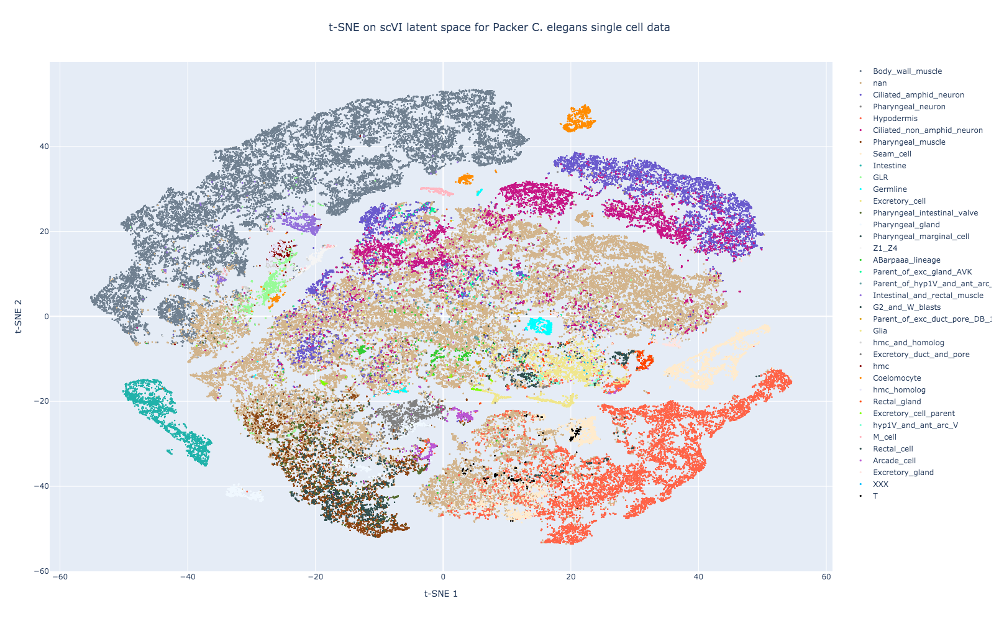

In [21]:
plot_embedding(embedding_kind='tsne', 
               cluster_feature ='cell_type', 
               xlabel="t-SNE 1", 
               ylabel="t-SNE 2", 
               plot_title="t-SNE on scVI latent space for Packer C. elegans single cell data")

## Plot interactive UMAP of cell subtypes 

In [22]:
umap_embedder = umap.UMAP()
umap_embedding = umap_embedder.fit_transform(latent)

post_adata.obsm["umap"] = np.array(umap_embedding)
print('UMAP embedding done!')

UMAP embedding done!


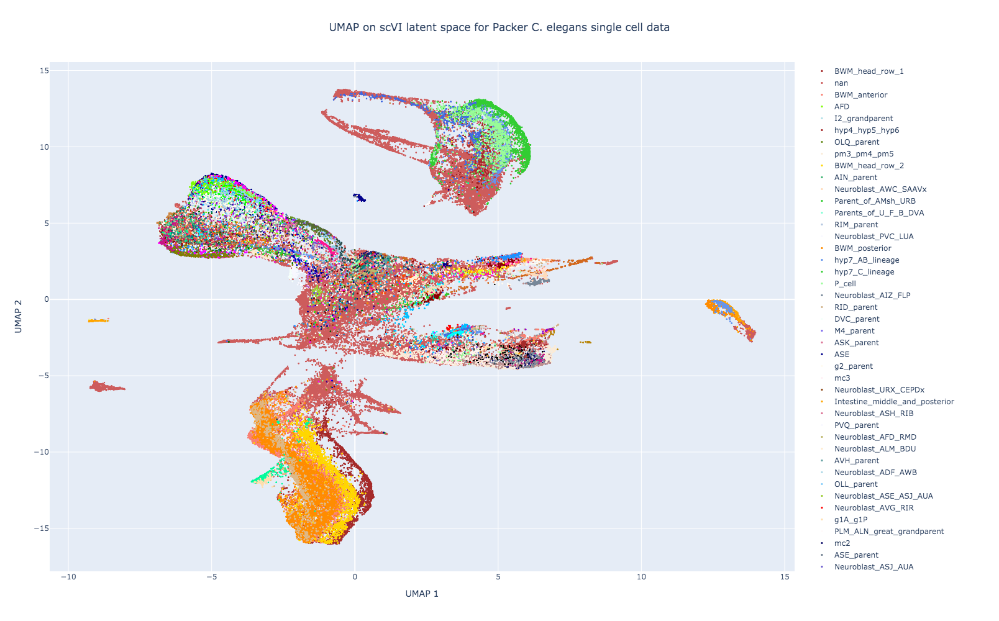

In [23]:
plot_embedding(embedding_kind='umap', 
               cluster_feature ='cell_subtype', 
               xlabel="UMAP 1", 
               ylabel="UMAP 2", 
               plot_title="UMAP on scVI latent space for Packer C. elegans single cell data")

# Plot interactive TSVD (PCA approximation) 
We can color our embeddings using any annotation stored as `category` type in the observation dataframe.

Let's see what we can use. 

In [24]:
post_adata.obs.dtypes

cell                     object
numi                      int64
time_point             category
batch                  category
size_factor             float64
cell_type              category
cell_subtype           category
plot_cell_type         category
raw_embryo_time           int64
embryo_time             float64
embryo_time_bin        category
raw_embryo_time_bin    category
lineage                category
passed_qc                  bool
dtype: object

TSVD embedding done!


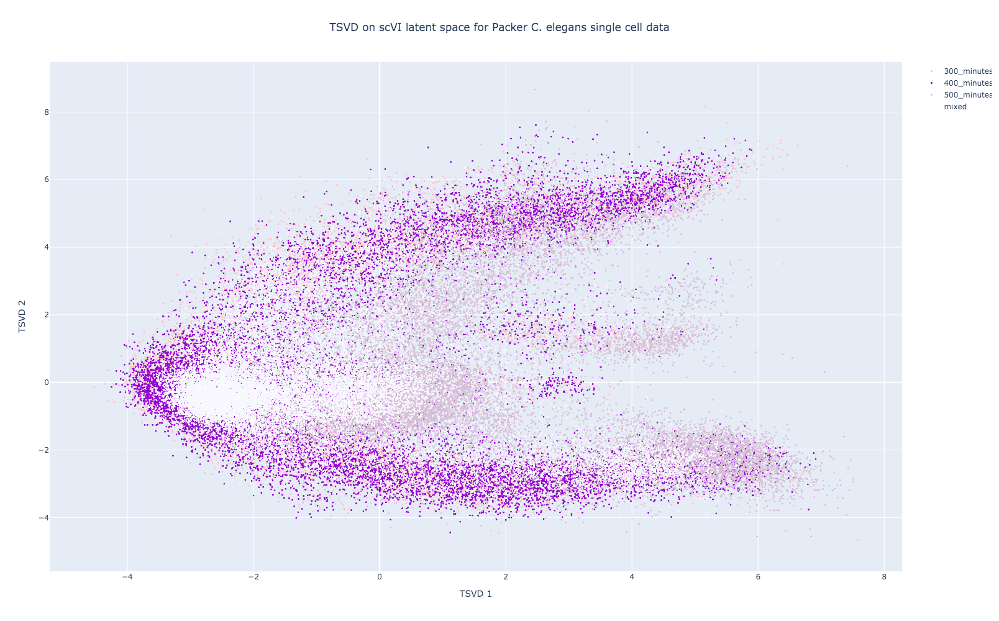

In [25]:
tsvd_embedder = TruncatedSVD(n_components=2)
tsvd_embedding = tsvd_embedder.fit_transform(latent)
post_adata.obsm["tsvd"] = np.array(tsvd_embedding)
print('TSVD embedding done!')

plot_embedding(embedding_kind='tsvd', 
               cluster_feature ='time_point', 
               xlabel="TSVD 1", 
               ylabel="TSVD 2", 
               plot_title="TSVD on scVI latent space for Packer C. elegans single cell data")

# Performing Differential Expression

<div style="max-width: 60em;">
<div class="alert alert-warning" role="alert">
    
**Note:** scVI recently introduced a second way to perform DE, and some functions and documentation are still changing.
The old mode is called `vanilla` and is performed here. The new mode is called `change` and has not made it into a release yet.
</div>

- From the trained VAE model we can sample the gene expression rate for each gene in each cell.  
- For two populations of interest, we can then randomly sample pairs of cells, one from each population to compare their expression rate for a gene. 
- In the `vanilla` mode, DE is measured by __logit(p/(1-p))__ where __p__ is the probability of a cell from population A having a higher expression than a cell from population B. 
- We can form the null distribution of the DE values by sampling pairs randomly from the combined population.


<div style="max-width: 60em;">

## Explanation of `Vanilla` DE mode (perfored in this notebook)

Explanation adapted from the scVi [`differential_expression_score` docstring](https://github.com/YosefLab/scVI/blob/05920d1f85daa362d4fb694e588ab090bc84e207/scvi/inference/posterior.py#L640).


The **`vanilla`** mode follows protocol described in [Lopez et al, arXiv:1709.02082](https://arxiv.org/abs/1709.02082).

In this case for a given gene we perform hypothesis testing based on latent variable in the generative model that models the mean of the gene expression. 

We are comparing $h_{1g}$, the mean expression of gene $g$ in cell type 1, with $h_{2g}$, the mean expression of $g$ in cell type 2. 
    
The hypotheses are:

$$
M^g_1: h_{1g} > h_{2g}
$$

$$
M^g_2: h_{1g} \leq h_{2g}
$$

DE between cell types 1 and 2 for each gene can then be based on the Bayes factors:

$$
\text{Bayes Factor for gene g in cell types 1 and 2} = B^g_{12}= \log{\frac{ p(M^g_1 | x_1, x_2)}{p(M^g_2 | x_1, x_2)}}
$$

To compute the gene specific Bayes factors using masks idx1 and idx2 we sample the Posterior in the following way:
   
1. The posterior is sampled `n_samples` times for each subpopulation
    
2. For computation efficiency (posterior sampling is quite expensive), instead of
    comparing element-wise the obtained samples, we can permute posterior samples.
    
Remember that computing the Bayes Factor requires sampling $q(z_A | x_A)$ and $q(z_B | x_B)$
    
#### Vanilla DE parameters

- `n_samples`: the number of times to sample the posterior gene frequencies from the vae model for each gene in each cell.
- `M_permutation`: Number of pairs sampled for comparison.
- `idx1`: boolean array masking subpopulation cells 1. (True where cell is from population) 
- `idx2`: boolean array masking subpopulation cells 2. (True where cell is from population) 


<div style="max-width: 60em;">

## Explanation of `Change` DE mode (not performed in this notebook yet)

The **`change`** mode follows the protocol described in [Boyeau et al, bioRxiv 2019. doi: 10.1101/794289](https://doi.org/10.1101/794289)

It consists in estimating an effect size random variable (e.g., log fold-change) and 
performing Bayesian hypothesis testing on this variable. 

The new `change_fn` function computes the effect size variable `r` based two inputs 
corresponding to the normalized means in both populations 

##### Hypotheses:
$M_1: r \in R_0$ (effect size r in region inducing differential expression)


$M_2: r \notin R_0$  (no differential expression)

To characterize the region $R_0$, the user has two choices. 

##### Option 1) Specify an interval
    
A common case is when the region $[-\delta, \delta]$ does not induce differential expression.    
    
If the user specifies a threshold delta, we suppose that $R_0 = \mathbb{R} \backslash [-\delta, \delta]$
    
##### Option 2) Specify an indicator function
Specify an specific indicator function $ \mathbb{1} : \mathbb{R} \mapsto \{0, 1\}  \text{  s.t.  }  r \in R_0 \iff \mathbb{1}(r) = 1$  
    
Decision-making can then be based on the estimates of $p(M_1 | x_1, x_2)$

In [26]:
# let's take a look at abundances of different cell types
adata.obs['cell_type'].value_counts()

nan                               35052
Body_wall_muscle                  17520
Hypodermis                         7746
Ciliated_amphid_neuron             6090
Ciliated_non_amphid_neuron         4468
Seam_cell                          2766
Pharyngeal_muscle                  2562
Glia                               1857
Intestine                          1732
Pharyngeal_neuron                  1471
Pharyngeal_marginal_cell            911
Coelomocyte                         787
Pharyngeal_gland                    786
GLR                                 768
Intestinal_and_rectal_muscle        568
Germline                            499
Pharyngeal_intestinal_valve         493
Arcade_cell                         434
Z1_Z4                               372
Rectal_cell                         327
M_cell                              315
ABarpaaa_lineage                    273
Rectal_gland                        265
Excretory_cell                      215
Excretory_gland                     205


In [27]:
# let's pick two cell types
cell_type_1 = 'Ciliated_non_amphid_neuron'
cell_type_2 = 'Ciliated_amphid_neuron'


cell_idx1 = adata.obs['cell_type'] == cell_type_1
print(sum(cell_idx1), 'cells of type', cell_type_1)
cell_idx2 = adata.obs['cell_type'] == cell_type_2
print(sum(cell_idx2), 'cells of type', cell_type_2)

4468 cells of type Ciliated_non_amphid_neuron
6090 cells of type Ciliated_amphid_neuron


In [28]:
n_samples = 100
M_permutation = 100000

In [29]:
de_res = full.differential_expression_score(
    cell_idx1, 
    cell_idx2, 
    n_samples=n_samples, 
    M_permutation=M_permutation,
)

### Print the vanilla differential expression results
- `bayes`**`i`**: The bayes factor for cell type 1 having a higher expression than cell type 2
- `bayes`**`i`**`_permuted`: estimate Bayes Factors of random populations of the union of the two cell populations
- `mean`**`i`**: average UMI counts in cell type **i**
- `nonz`**`i`**: proportion of non-zero expression in cell type **i**
- `norm_mean`**`i`**: average UMI counts in cell type **i** normalized by cell size
- `scale`**`i`**: average scVI imputed gene expression scale in cell type **i**


In [30]:
de_res.head()

,bayes1,bayes1_permuted,bayes2,bayes2_permuted,mean1,mean2,nonz1,nonz2,norm_mean1,norm_mean2,scale1,scale2
WBGENE00016958,1.764321,-0.00476,-1.753073,0.00284,0.000000,0.000000,0.00000,0.000000,0.156134,0.040103,0.003160,0.001342
WBGENE00019867,1.335749,-0.00464,-1.322697,-0.00912,0.000000,0.000000,0.00000,0.000000,0.408239,0.214505,0.000818,0.000416
WBGENE00006380,1.254628,-0.00696,-1.248095,-0.00268,0.000000,0.000000,0.00000,0.000000,0.081103,0.095868,0.002416,0.001434
WBGENE00022242,1.183798,-0.00064,-1.184077,-0.00844,10.452090,10.253184,0.95019,0.932108,0.359945,0.145921,0.000639,0.000391
WBGENE00013982,1.166435,-0.00644,-1.162353,-0.00568,0.298859,0.407353,0.04981,0.067892,0.913714,0.229633,0.000512,0.000239


In [31]:
de_res.describe()

,bayes1,bayes1_permuted,bayes2,bayes2_permuted,mean1,mean2,nonz1,nonz2,norm_mean1,norm_mean2,scale1,scale2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,-0.090899,0.001921,0.095629,0.002331,0.972552,0.977109,0.252146,0.252562,1.000001,1.000001,0.001000,0.001000
std,0.402527,0.005737,0.403697,0.007668,3.630539,3.585305,0.421117,0.416769,4.022550,2.919382,0.003487,0.003101
min,-1.925405,-0.015720,-1.753073,-0.020841,0.000000,0.000000,0.000000,0.000000,0.002542,0.001374,0.000019,0.000019
25%,-0.320711,-0.002020,-0.104234,-0.003560,0.000000,0.000000,0.000000,0.000000,0.062939,0.063196,0.000111,0.000127
50%,-0.125083,0.002100,0.128798,0.002940,0.000000,0.000000,0.000000,0.000000,0.186607,0.189790,0.000287,0.000310
75%,0.108216,0.006160,0.329314,0.008320,0.950190,0.932108,0.950190,0.932108,0.753789,0.874205,0.000803,0.000815
max,1.764321,0.016000,1.904589,0.022321,66.563103,65.315422,1.000000,1.000000,90.680054,53.232780,0.058149,0.059593


In [32]:
# manipulate the DE results for plotting
de = de_res.copy()

de['ratio_mean12']=de['mean1']/de['mean2']
de['ratio_scale12']=de['scale1']/de['scale2']

de['log_scale_ratio']=np.log(de['ratio_scale12'])
de['log_mean_ratio']=np.log(de['ratio_mean12'])

de['abs_bayes_factor']=np.abs(de['bayes1'])

de['ratio_norm_mean12']=de['norm_mean1']/de['norm_mean2']
de['log_norm_mean_ratio']=np.log(de['ratio_norm_mean12'])

#make a copy of the annotated gene metadata with gene ids all lower case to avoid problems when joining dataframes
adata_var_uppercase = adata.var.copy()
adata_var_uppercase.index = adata_var_uppercase.index.str.upper()

#convert top_expression gene ids index to lowercase for joining with metadata
de=de.join(adata_var_uppercase, how='inner')


In [33]:
de.head().T

,WBGENE00016958,WBGENE00019867,WBGENE00006380,WBGENE00022242,WBGENE00013982
bayes1,1.76432,1.33575,1.25463,1.1838,1.16643
bayes1_permuted,-0.00476001,-0.00464001,-0.00696003,-0.00064,-0.00644002
bayes2,-1.75307,-1.3227,-1.2481,-1.18408,-1.16235
bayes2_permuted,0.00284,-0.00912006,-0.00268,-0.00844005,-0.00568002
mean1,0,0,0,10.4521,0.298859
mean2,0,0,0,10.2532,0.407353
nonz1,0,0,0,0.95019,0.0498099
nonz2,0,0,0,0.932108,0.0678922
norm_mean1,0.156134,0.408239,0.0811029,0.359945,0.913714
norm_mean2,0.0401034,0.214505,0.0958682,0.145921,0.229633


# Volcano plot of DE between two clusters

Because we're using the vanilla mode, note that this volcano plot shows the ratios of the **scVI expression scale** of the two tissues vs the **absolute value of the bayes factor**.

The new `change` mode allows for calculating log fold change and p-values, which are more commonly seen in volcano plots

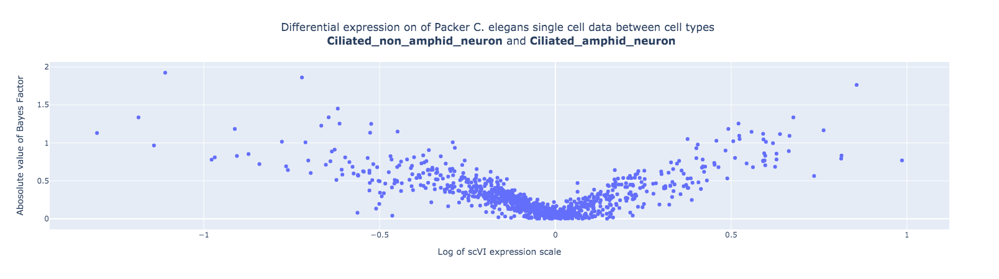

In [34]:
# first we create these variables to customize the hover text in plotly's heatmap
# the text needs to be arranged in a matrix the same shape as the heatmap
# for the gene descriptions text, which can be several sentences, we add a line break after each sentence
de['gene_description_html'] = de['gene_description'].str.replace('\. ', '.<br>')

fig = go.Figure(
                data=go.Scatter(
                          x=de["log_scale_ratio"].round(3)
                        , y=de["abs_bayes_factor"].round(3)
                        , mode='markers'
#                         , label=de['gene_name']
#                         , marker=dict(color=de['log_mean_ratio'],
#                                     colorscale='mint', 
#                                     size=6, colorbar=dict(thickness=20))
                        , hoverinfo='text'
#                         , hoverlabel=dict(de['gene_name'])
                        , text=de['gene_description_html']
                        , customdata=de.gene_id.values + '<br>Name: ' + de.gene_name.values
                        , hovertemplate='%{customdata} <br>' +
                                        'Absolute Bayes Factor: %{y}<br>' +
                                        'Log scale ratio: %{x}' +
                                        '<extra>%{text}</extra>'
                        )
                        , layout= {
                                "title": {"text": 
                                          "Differential expression on of Packer C. elegans single cell data between cell types <br> <b>" +
                                          str(cell_type_1) + "</b> and <b>" + str(cell_type_2) + " "
                                          , 'x':0.5        
                                         }
                                , 'xaxis': {'title': {"text": "Log of scVI expression scale"}}
                                , 'yaxis': {'title': {"text": "Abosolute value of Bayes Factor"}}
    #                             , "height": 600,
    #                             , "width":1000
                        }
               )
fig.show()


# Heatmap of top expressed genes

Now we perform DE between each cell type vs all other cells and make a heatmap of the result.

First we need to make cell type sumary with numerical codes for each cell type

In [35]:
# we need to numerically encode the cell types for passing the cluster identity to scVI
cell_code_to_type = dict( zip( adata.obs['cell_type'].cat.codes, adata.obs['cell_type'] ) )
cell_type_to_code_map = dict([[v,k] for k,v in cell_code_to_type.items()])
# check that we got unique cell type labels
assert len(cell_code_to_type)==len(cell_type_to_code_map)

cell_types_summary=pd.DataFrame(index=adata.obs['cell_type'].value_counts().index)
cell_types_summary['cell_type_code']=cell_types_summary.index.map(cell_type_to_code_map)
cell_types_summary['ncells']=adata.obs['cell_type'].value_counts()
cell_types_summary['cell_type_name']=adata.obs['cell_type'].value_counts().index
cell_types_summary.to_csv('packer_cell_types_summary.csv')
cell_types_summary.head()

,cell_type_code,ncells,cell_type_name
nan,36,35052,nan
Body_wall_muscle,2,17520,Body_wall_muscle
Hypodermis,14,7746,Hypodermis
Ciliated_amphid_neuron,3,6090,Ciliated_amphid_neuron
Ciliated_non_amphid_neuron,4,4468,Ciliated_non_amphid_neuron


In [36]:
# create a column in the cell data with the cluster id each cell belongs to
adata.obs['cell_type_code'] = adata.obs['cell_type'].cat.codes

# this returns a list of dataframes with DE results (one for each cluster), and a list with the corresponding cluster id
per_cluster_de, cluster_id = full.one_vs_all_degenes(cell_labels=adata.obs['cell_type_code'].ravel(), min_cells=1)

In [37]:
# pick the top 10 genes in each cluster
top_genes = []
for x in per_cluster_de:
    top_genes.append(x[:10])
top_genes = pd.concat(top_genes)
top_genes = np.unique(top_genes.index)

In [38]:
# fetch the expression values for the top 10 genes
top_expression = [x.filter(items=top_genes, axis=0)['norm_mean1'] for x in per_cluster_de]
top_expression = pd.concat(top_expression, axis=1)
top_expression = np.log10(1 + top_expression)
cluster_name = [cell_code_to_type[_id] for _id in cluster_id]
top_expression.columns=cluster_name

# convert into anndata object to tie with more metadata, such as gene names and descriptions
top_expression = anndata.AnnData(top_expression.T)
top_expression.obs = top_expression.obs.join(cell_types_summary)
top_expression.obs.head()

,cell_type_code,ncells,cell_type_name
ABarpaaa_lineage,0,273,ABarpaaa_lineage
Arcade_cell,1,434,Arcade_cell
Body_wall_muscle,2,17520,Body_wall_muscle
Ciliated_amphid_neuron,3,6090,Ciliated_amphid_neuron
Ciliated_non_amphid_neuron,4,4468,Ciliated_non_amphid_neuron


In [39]:
#make a copy of the annotated gene metadata with gene ids all lower case to avoid problems when joining dataframes
adata_var_lowcase = adata.var.copy()
adata_var_lowcase.index = adata_var_lowcase.index.str.lower()

#convert top_expression gene ids index to lowercase for joining with metadata
top_expression.var.index = top_expression.var.index.str.lower()
top_expression.var=top_expression.var.join(adata_var_lowcase)

top_expression.var.index=top_expression.var['gene_id']
top_expression.var.head().style.set_properties(subset=['gene_description'], **{'width': '600px'})

,gene_id,gene_name,gene_description
gene_id,,,
WBGene00000064,WBGene00000064,act-2,"Is an ortholog of human ACTB (actin beta). Is predicted to have ATP binding activity. Is involved in several processes, including cortical actin cytoskeleton organization; cytoskeleton-dependent cytokinesis; and embryo development. Localizes to the actin filament and cell cortex. Is expressed in body wall musculature; gonad; nervous system; and the hypodermis. Human ortholog(s) of this gene are implicated in several diseases, including artery disease (multiple); intrinsic cardiomyopathy (multiple); and myopathy (multiple)."
WBGene00000172,WBGene00000172,aqp-4,Is an ortholog of human AQP8 (aquaporin 8). Exhibits water channel activity. Is involved in water transport. Localizes to the apical plasma membrane. Is expressed in intestine.
WBGene00000229,WBGene00000229,atp-2,"Is an ortholog of human ATP5F1B (ATP synthase F1 subunit beta). Exhibits protein domain specific binding activity. Is predicted to contribute to ATPase activity and proton-transporting ATP synthase activity, rotational mechanism. Is involved in several processes, including determination of adult lifespan; inductive cell migration; and pharyngeal pumping. Localizes to the mitochondrion and non-motile cilium. Is expressed in HOB; head; ray neuron type B; and tail."
WBGene00000370,WBGene00000370,ccg-1,Is enriched in PLM; coelomocyte; germ line; and muscle cell based on tiling array; RNA-seq; and microarray studies. Is affected by several genes including daf-16; daf-2; and glp-1 based on microarray; proteomic; and RNA-seq studies. Is affected by twelve chemicals including aldicarb; Rotenone; and D-glucose based on microarray and RNA-seq studies.
WBGene00000429,WBGene00000429,ceh-2,Is an ortholog of human EMX1 (empty spiracles homeobox 1). Is predicted to have DNA binding activity. Localizes to the nucleus. Is expressed in nervous system; pharynx; somatic nervous system; and vulva.


## Create interactive heatmap with plotly
In this heatmap we plot the

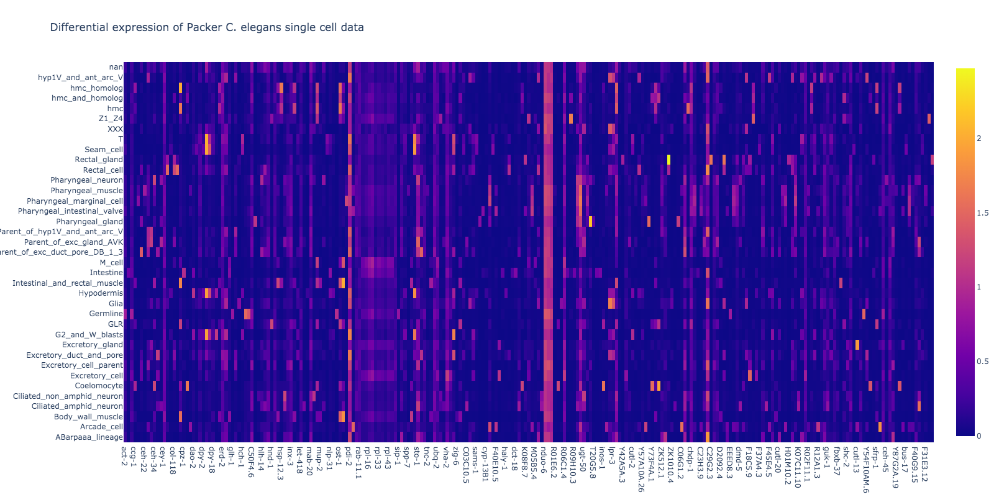

In [40]:
# first we create these variables to customize the hover text in plotly's heatmap
# the text needs to be arranged in a matrix the same shape as the heatmap
# for the gene descriptions text, which can be several sentences, we add a line break after each sentence
top_expression.var['gene_description_html'] = top_expression.var['gene_description'].str.replace('\. ', '.<br>')
gene_description_text_matrix = np.tile(top_expression.var['gene_description_html'].values, (len(top_expression.obs['cell_type_name']),1) )
gene_ids_text_matrix = np.tile(top_expression.var['gene_id'].values, (len(top_expression.obs['cell_type_name']),1))


# now create the heatmap with plotly
fig = go.Figure(
                data=go.Heatmap(
                        z=top_expression.X.round(3),
                        x=top_expression.var['gene_name'],
                        y=top_expression.obs['cell_type_name'],
                        hoverinfo='text',
                        text=gene_description_text_matrix,
                        customdata=gene_ids_text_matrix,
                        hovertemplate='%{customdata} <br>Name: %{x}<br>Cell type: %{y}<br>Expression: %{z}  <extra>%{text}</extra>',
                        ),
                    layout= {
                        "title": {"text": "Differential expression of Packer C. elegans single cell data"},
                        "height": 800,
                        },
               )
fig.show()